# Testiharjoitus 2/2 - TIEA2300 - Koneoppimisen perusteet

- Tämän tehtävä on suoritettava hyväksytysti suorittaaksesi kurssin Koneoppimisen perusteet.
- Tehtävä palautettava **viimeistään 26.5. toukokuuta 23.59.**
- Ajoissa palautetut tehtävät **arvostellaan** asteikolla 0,1,..,5
- Kurssin arvosana on **kahden testiharjoituksen keskiarvo**
- Tehtävä on tarkoitettu **itsenäisesti suoritettavaksi**, joten varaudu perustelemaan vastauksiasi kurssin opettajille (**saatamme kysyä tarkennuksia** esimerkiksi arvostelua varten tai pelkästään pistokokeena ennen arvosanan päättämistä)
- Opettajat eivät anna suoria vastauksia siihen miten jokin osakokonaisuus toteutetaan, mutta toki voi pyytää ohjeita (email tai lyhyt zoom-palaveri ohjaajan kanssa), jos tehtävien annon suhteen epävarmuutta ymmärrätkö oikein (tässä voi myös käyttää kaveria hyödyksi ja keskustella ymmärtääkö hän samoin ja sitten palata itsenäiseen työhön)
- HUOMAA: **Palauta Jupyter Notebook muodossa** siten että kirjoitat kuhunkin kohtaan lyhyen kuvauksen siitä mitä ja miksi on tehty.
- Tehtävän suorittamisessa auttaa huomattavasti tähän astisten luentoesimerkkien ja demojen tekeminen ja testailu
- Hyödynnä sklearn-dokumentaatiota ja lukuisia tarjolla olevia ohjeita Python, numpy pakettien käytöstä

## Tehtävän kuvaus (maksimipistemäärä 10p) 

Tehtävänäsi on kehittää paras mahdollinen ennustemalli käsin kirjoitettujen numeroiden luokitteluun satunnaismetsäluokittelijan avulla.

- Käytä scikit-learn-kirjaston load_digits-aineistoa (https://scikit-learn.org/stable/modules/generated/sklearn.datasets.load_digits.html).

- Vinkki vaiheisiin 5-8: voit lukea artikkelin (https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74) ja hyödyntää osin siinä esitettyjä tietoja ja koodia. Huomioi että artikkelin esimerkki käsittelee regressio-ongelmaa, ja tässä tapauksessa kyseessä on luokittelu.

<p>
    
- Toteuta seuraavat vaiheet:

### 1 Datan tuominen tiedostosta (0.5p)

Importataan tehtävässä tarvittavia kirjastoja ja ladataan käytettävä datasetti.

In [1]:
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV
from sklearn.preprocessing import Normalizer, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
import matplotlib.pyplot as plt
import numpy as np
import random

data = load_digits()


### 2 Syötematriisin ja vastemuuttujan muodostaminen (0.5p)

Käytettävästä datasta löytyy syötematriisi(data) ja vastemuuttujat(target).
Muuttujaan X syötematriisi ja muuttujaan y vastemuuttujat.

In [2]:
X = data['data']
y = data['target']


### 3 Opetus- ja testidatan valinta (1p)

Opetus ja testidatan jako tehdään train_test_split moduulilla ja valitaan testidatan kooksi 33% kokonaisaineistosta.

In [3]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)

### 4 Datan esikäsittely (1p)

Normalisoidaan data. Käytetään Normalizerin transform metodia, koska pelkkä fittaus ei tekisi Normalizerissä mitään. Näin saadaan datasta hieman parempaa.

In [4]:
nl = Normalizer()
nl_tr = nl.transform(X_test)



### 5 Hyperparametrien valinta - osa 1 (2p)

- Käytä sklearn.model_selection.RandomizedSearchCV
- Säädä vähintään kuutta hyperparametria.

RandomizedSearchCVtä on hyvä käyttää alkuun että saadaan jonkinlainen suunta mitkä voisivat olla parhaita parametreja. n_iterin arvo kertoo montako kertaa randomilla eri kombinaatioita kokeillaan ja GridSearchCVtä voidaan käyttää tämän jälkeen, randomin antamilla arvoilla ja hieman pienemillä ja suuremilla arvoilla.


In [5]:
rf = RandomForestClassifier()
rs_params = {
    'n_estimators': [10,40,80,110,150,180],
    'max_features': ['auto', 'sqrt'],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf':[1, 2, 3, 4],
    'max_depth': [5, 10, 20, 30, 40, 50],
    'bootstrap': [True, False]
}

clf = RandomizedSearchCV(estimator = rf, param_distributions = rs_params, n_iter = 100, cv = 10, verbose=2, random_state=42, n_jobs = -1)
clf.fit(nl_tr, y_test)
print(clf.best_params_)
parametrit = clf.best_params_

Fitting 10 folds for each of 100 candidates, totalling 1000 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:   13.0s
[Parallel(n_jobs=-1)]: Done 341 tasks      | elapsed:   25.0s
[Parallel(n_jobs=-1)]: Done 624 tasks      | elapsed:   36.8s
[Parallel(n_jobs=-1)]: Done 1000 out of 1000 | elapsed:   54.0s finished
{'n_estimators': 110, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': 20, 'bootstrap': True}


### 6 Hyperparametrien valinta - osa 2 (2p)

- Käytä sklearn.model_selection.GridSearchCV 
- Hyödynnä edellisessä kohdassa saatua tietoa hyperparametreistä tässä kohdassa


Käytetään RandomSearchCV:tä hyödyksi ja otetaan sieltä parhaat parametrit. Jokaiseen parametriin lisätään/vähennetään valittu luku ja käydään GridSearchCVllä etsimässä parhaat parametrit malliin. 

In [6]:
gs_params = {
    'n_estimators': [parametrit['n_estimators'], parametrit['n_estimators']+10, parametrit['n_estimators']-10],
    'max_features': ['auto', 'sqrt'],
    'min_samples_split': [parametrit['min_samples_split'],parametrit['min_samples_split']+1],
    'min_samples_leaf':[parametrit['min_samples_leaf'], parametrit['min_samples_leaf']+1],
    'max_depth': [parametrit['max_depth'],parametrit['max_depth']+10,parametrit['max_depth']-10],
    'bootstrap': [True, False]
}

clf = GridSearchCV(rf, gs_params, cv=10)
model = clf.fit(nl_tr, y_test)
print(model.best_params_)
final_pr = model.best_params_

{'bootstrap': False, 'max_depth': 10, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 110}


### 7 Tulosten pohdinta (1.5p)

Pohdi lyhyesti oliko RandomizedSearchCV:n käytöstä ennen GridSearchCV:tä apua tässä tapauksessa, ja myös millaisessa tilanteessa siitä yleisesti voisi olla apua. (1,5p)

Oikeastaan joo. RandomizedSearchCV antaa kuitenkin osviittaa suuntaan mitä parhaat hyperparametrit olisivat ja näin nopeuttaa prosessia. Jos pelkästään GridSearchilla olisi tehty, olisi suoritusaika kasvanut.

### 8. Visualisointi (1.5p)

Tutki visuaalisesti mikä puiden määrä (n_estimators) voisi olla sopiva tässä tapauksessa. Perustele vastauksesi. (1,5p)

Tutkitaan RandomforestClassifierin estimators_ parametrin avulla metsän puita. Suoritusajoista ja osittain selkeydestä johtuen, tutkitaan vain kymmentä puuta sadasta (randomilla).

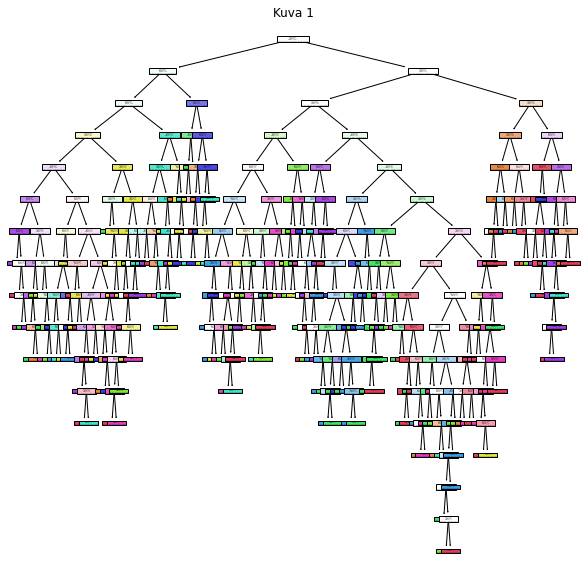

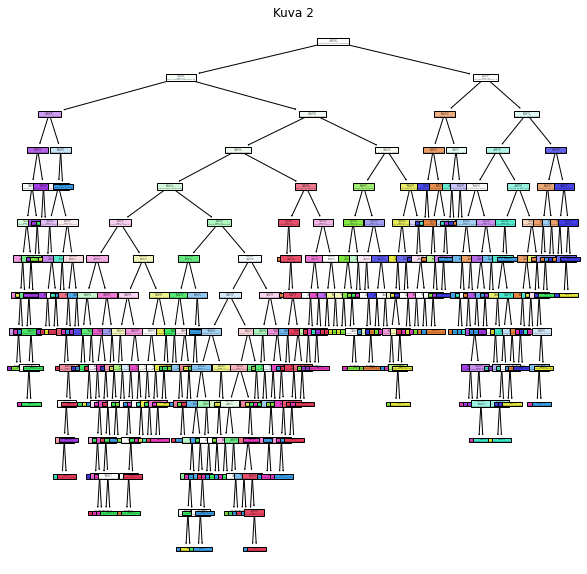

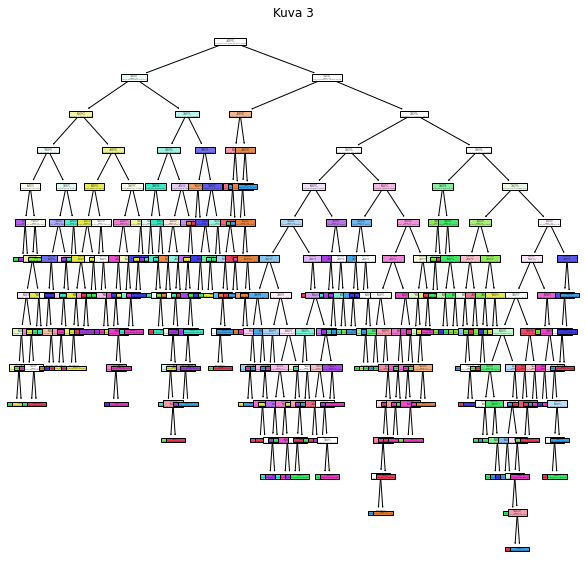

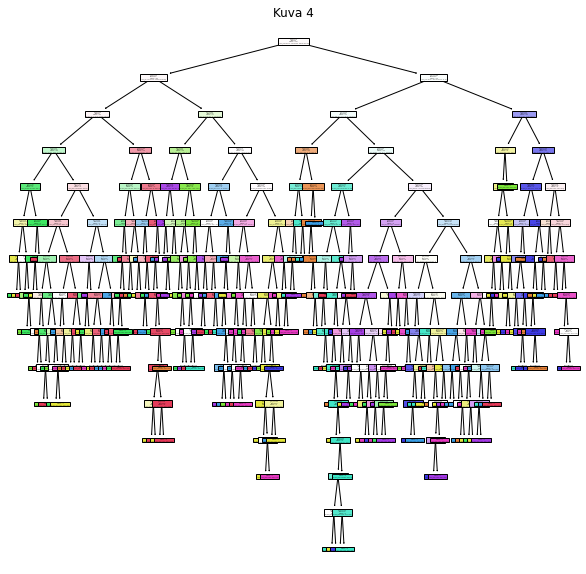

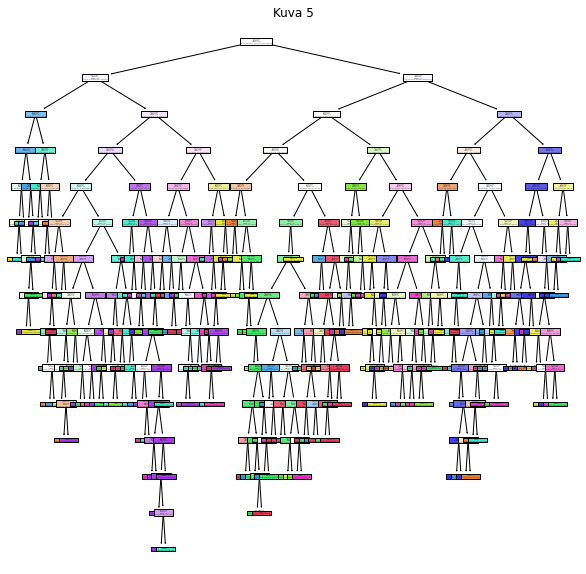

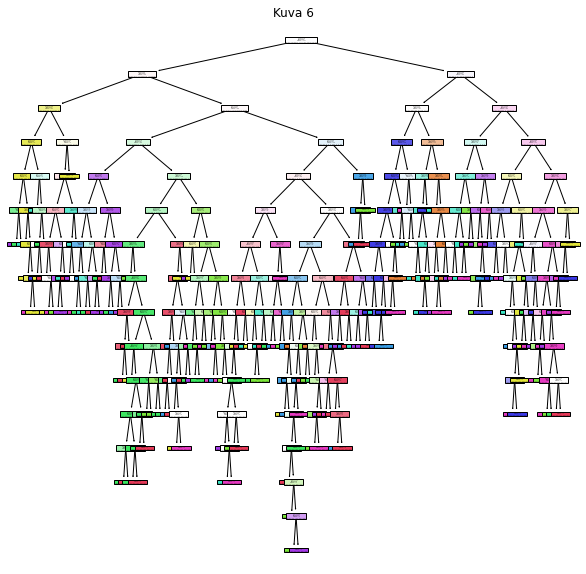

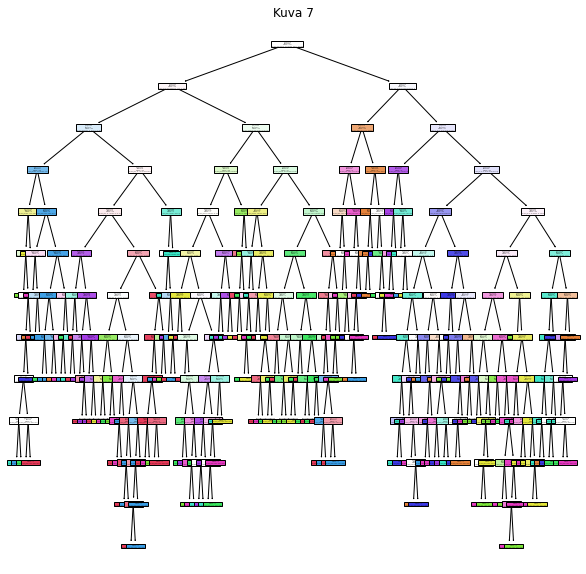

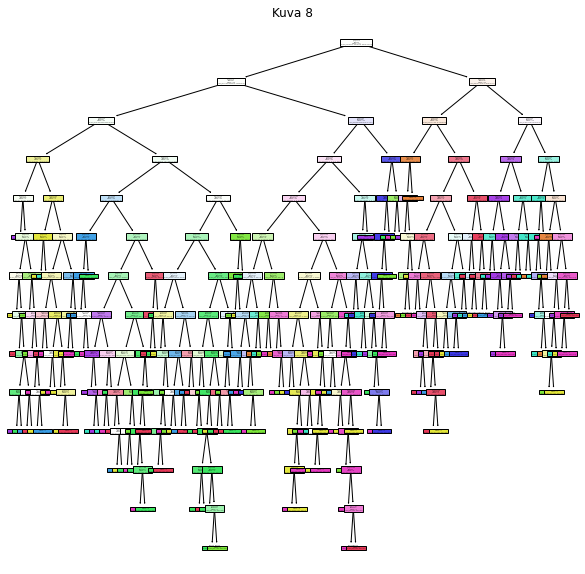

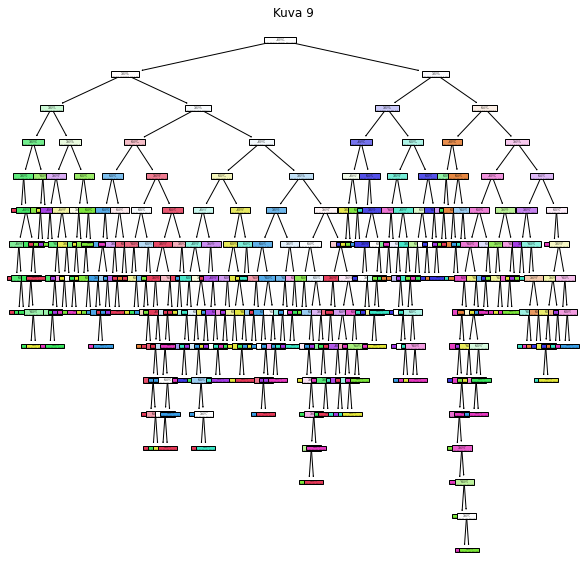

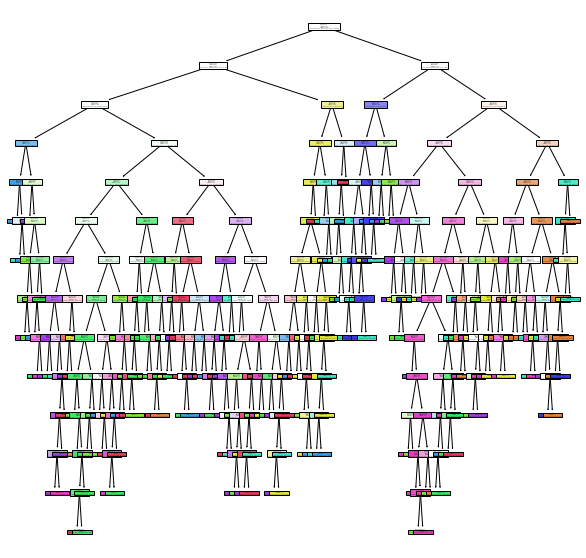

In [10]:

rf.fit(X,y)

len_est = len(rf.estimators_)

j = 0
for i in range(len_est):
    plt.figure(figsize=(10,10))
    _ = tree.plot_tree(rf.estimators_[j], filled=True)
    k = i+1
    j = j+10
    if j >= len_est: 
        break
    plt.title("Kuva %s" %k)
    plt.show()



Plotatuista puista Kuva 9 olisi paras (lyhimmät reitit lehtisolmuihin). En ole aivan varma onko visualisointi valintani tässä se oikea. Jos ei ole niin olisi mielenkiintoista palautteessa kuulla mikä olisi ollut oikea.